In [1]:
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from numba import jit
from numba import njit, prange
import math

In [2]:
from dart_tracker_functions import*

In [3]:
#uploading dart throwing data and coinverting to csv
with open('C:/Users/msind/Box Sync/code/darts/nightly_darts_data.csv') as fhand:
    df = pd.read_csv(fhand)

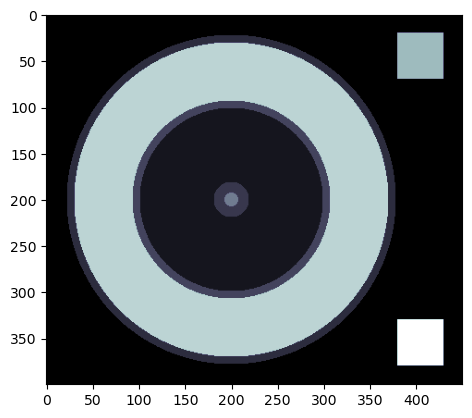

In [4]:
#create an array to define dart board regions (bullseye, 2x, 3x, etc..)
score_position_array = generate_position_array()
plt.imshow(score_position_array, cmap = 'bone')

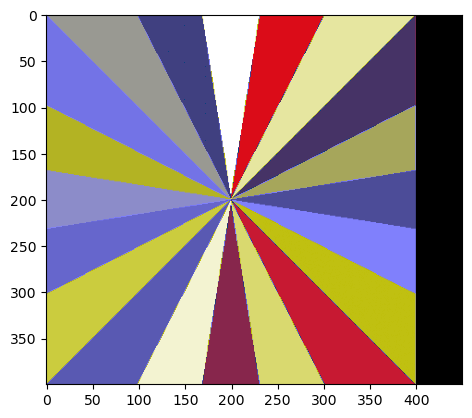

In [5]:
#create an array to define dart board scores
score_number_array = generate_number_array()
plt.imshow(score_number_array, cmap = 'gist_stern')

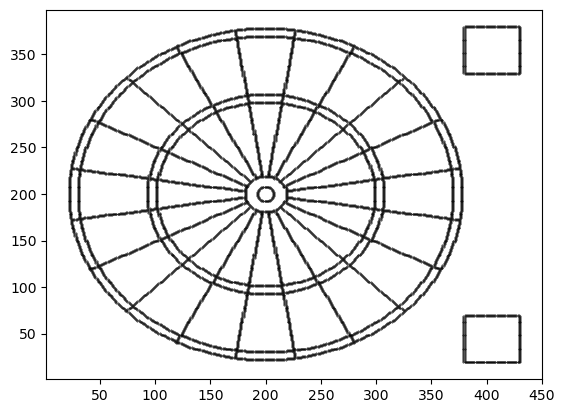

In [6]:
#creat an array to outline dart board sections
boarders_y_coords, boarders_x_coords = generate_outline_array(score_position_array, score_number_array)
plt.scatter(boarders_x_coords, boarders_y_coords, s = 0.1, color = 'black')

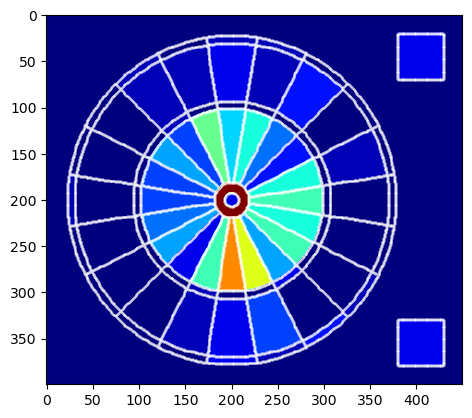

In [7]:
#creates a 3D array based oin darts thrown
#first dimension is each individual throw
frequency_array = generate_frequency_array(df, score_position_array, score_number_array)
plt.imshow(frequency_array[200, :, :], cmap='jet')
plt.scatter(boarders_x_coords, boarders_y_coords, s = 0.1, color = 'white')

In [8]:
df

,date,round,throw_num,position,score
0,2023_01_26,1,1,0.8,18
1,2023_01_26,1,2,0.2,12
2,2023_01_26,1,3,0.8,18
3,2023_01_26,2,4,0.8,18
4,2023_01_26,2,5,0.1,8
...,...,...,...,...,...
451,2023_02_18,7,20,0.1,3
452,2023_02_18,7,21,0.1,8
453,2023_02_18,8,22,0.1,19
454,2023_02_18,8,23,0.1,2


In [9]:
mode_position = df['position'].value_counts()
mode_number = df['score'].value_counts()

#determining if the mode is a a score coded with 0.0
#if it is, that value frequency becomes the ceiling
if mode_position.index[0] in [0.25, 0.50, 0.70, 0.99]:
    ceiling_value = mode_position.iloc[0]

#if the most often is one of the 1-20 scores, this is how the ceiling is determiend
else:
    if mode_number.index[0] == 0.0:
        ceiling_value = mode_number.iloc[1] 
    else:
        ceiling_value = mode_number.iloc[0] 


C:\Users\msind\AppData\Local\Temp\ipykernel_13856\2195175081.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


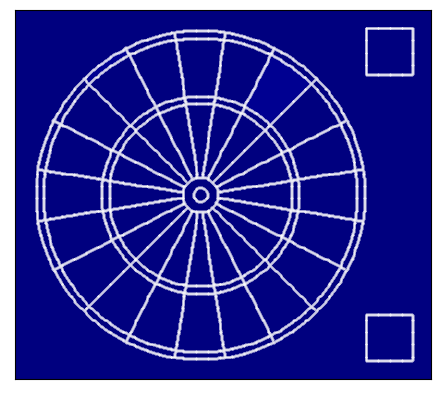

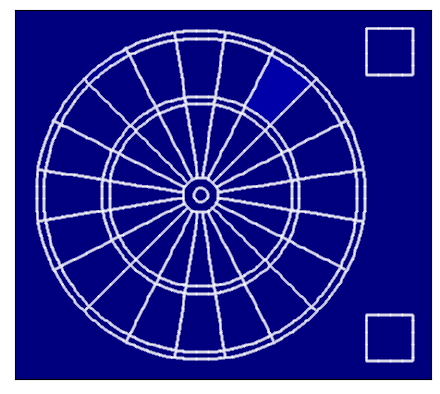

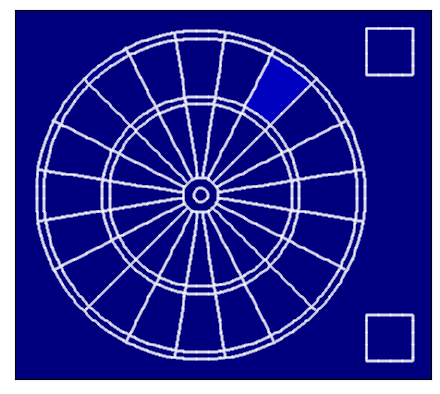

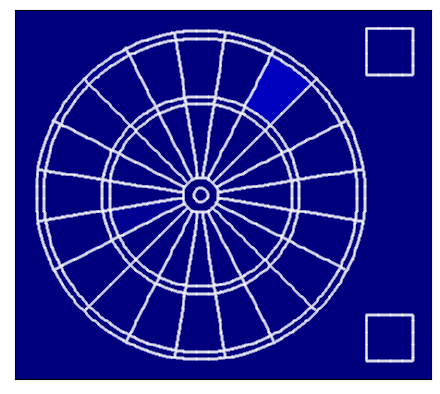

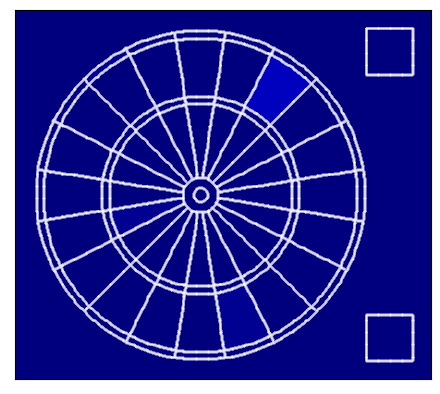

...

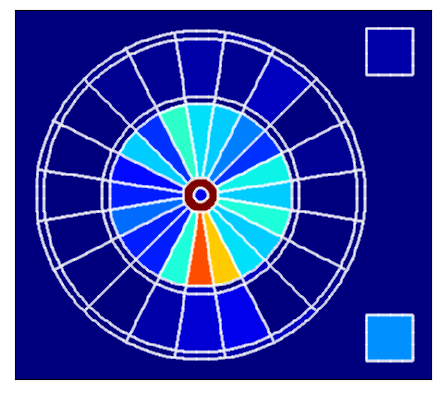

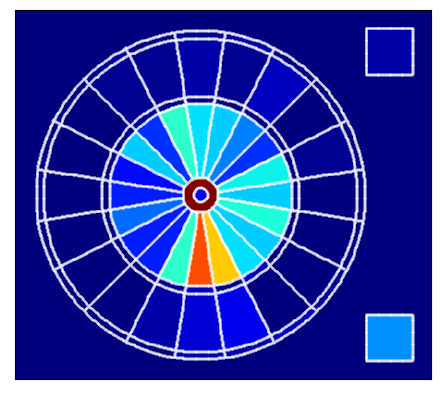

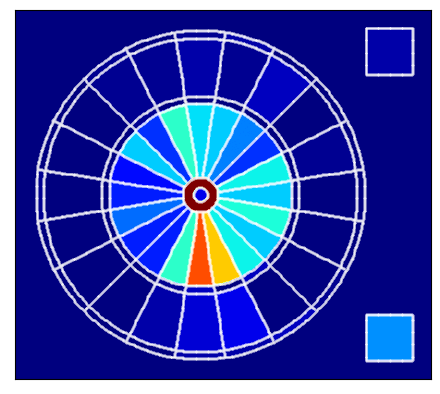

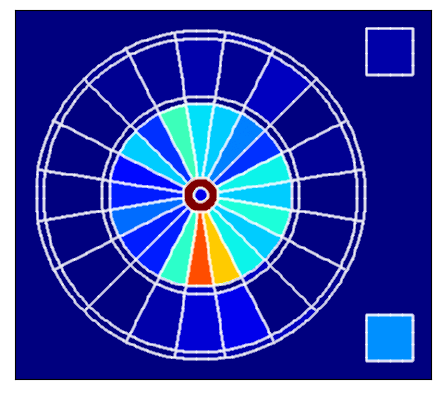

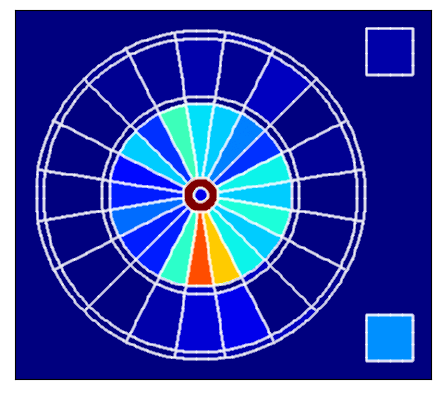

In [10]:
iteration = 0

for i in range(len(frequency_array[:, 0, 0])):
    fig, ax = plt.subplots()
    im = ax.imshow(frequency_array[i, :, :], vmin=0, vmax=ceiling_value, cmap='jet')
    ax.scatter(boarders_x_coords, boarders_y_coords, s=0.1, color='white')
    ax.set_xticks([])
    ax.set_yticks([])
#     cbar = ax.figure.colorbar(im, ax=ax)
    plt.savefig('C:/Users/msind/Box Sync/code/darts/dart_video_images/dart_'+str(iteration)+'.jpeg', dpi = 300,  bbox_inches="tight")
    iteration += 1
#     plt.show()